<a href="https://colab.research.google.com/github/DazhiZhong/Pixray_Notebooks/blob/main/Intro_and_Quickstart_thread.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Follow [@DazhiZhong](https://twitter.com/DazhiZhong) for threads like these :)

#### Hi! This will be the first of many threads that try to help artists make unique and creative art using AI art models!  

# 🧵 - An overview on AI art and a quickstart into @pixray

#### Remember, all code from this thread will be in the public notebook: [dazhi.art/h/introthread](https://dazhi.art/h/introthread)

<img src="https://dazhi.art/i/thread 1 cover.png" height="250">

#### For most art engines, 2 models are needed in combination of each other: an "artist" model and a "critic" model. The artist starts out as a blank state, it knows nothing and doesn't make very good-looking art. 

<img src="https://dazhi.art/i/artist.png" height="250">

#### However, every time it makes a new piece, the critic comes in and says, "this doesn't look like the prompt, here's how you can improve"
#### as such, the artist learns little by little and makes better and better art, until either the artist can't make anything better, or the critic can't pick out any problems and is satisfied.
#### This kind of dynamic is the basis of most AI art generators, with exceptions of course.

<img src="https://dazhi.art/i/artistncritic.png" height="250">

#### It's interesting that the artist is unable to make art that we want without pushing it towards that direction by a critic. But conversely, the critic is also unable to make art on its own because it doesn't have the ability to actually create - it *has* to rely on the artist.

#### Pixray also uses this type of architecture, abstracting some parts of it into modularized classes, which can easily be added, modified, or replaced: Filters and Losses allows us to control the content & looks of the art, the Drawers allows different drawing styles.

<img src="https://dazhi.art/i/modularize.png" height="250">

#### With a macro understanding of image generators as a whole, let us dive into pixray, and start generating art for ourselves.

#### First step, install pixray and its dependencies (namely diffvg and v-diffusion):
#### and don't forget to change the accelerator type to "GPU" in Colab


In [ ]:
#@title Installing { vertical-output: true }
!pip uninstall -y tensorflow
!git clone https://github.com/pixray/pixray
!cd pixray && git checkout 42fda62
!pip install -r pixray/requirements.txt
!git clone https://github.com/pixray/v-diffusion-pytorch
!cd v-diffusion-pytorch && git checkout 29f363f
!cp -r v-diffusion-pytorch/diffusion pixray/.
!git clone --recursive https://github.com/pixray/diffvg
!cd diffvg && git checkout c40ec08
!cd diffvg && python setup.py install
!mkdir models

Found existing installation: tensorflow 2.7.0
Uninstalling tensorflow-2.7.0:
  Successfully uninstalled tensorflow-2.7.0
Cloning into 'pixray'...
remote: Enumerating objects: 851, done.
remote: Counting objects: 100% (56/56), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 851 (delta 30), reused 38 (delta 17), pack-reused 795
Receiving objects: 100% (851/851), 286.42 KiB | 8.42 MiB/s, done.
Resolving deltas: 100% (538/538), done.
Looking in links: https://download.pytorch.org/whl/torch_stable.html
  Cloning https://github.com/bfirsh/taming-transformers.git (to revision 7a6e64ee) to /tmp/pip-req-build-n373lgq3
  Running command git clone -q https://github.com/bfirsh/taming-transformers.git /tmp/pip-req-build-n373lgq3
  Running command git checkout -q 7a6e64ee
  Cloning https://github.com/openai/CLIP (to revision 573315e) to /tmp/pip-req-build-us6kuyox
  Running command git clone -q https://github.com/openai/CLIP /tmp/pip-req-build-us6kuyox
  Running command git chec

Cloning into 'v-diffusion-pytorch'...
remote: Enumerating objects: 62, done.
remote: Counting objects: 100% (36/36), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 62 (delta 19), reused 26 (delta 12), pack-reused 26
Unpacking objects: 100% (62/62), done.
Cloning into 'diffvg'...
remote: Enumerating objects: 283, done.
remote: Total 283 (delta 0), reused 0 (delta 0), pack-reused 283
Receiving objects: 100% (283/283), 10.27 MiB | 18.45 MiB/s, done.
Resolving deltas: 100% (107/107), done.
Submodule 'pybind11' (https://github.com/pybind/pybind11.git) registered for path 'pybind11'
Submodule 'thrust' (https://github.com/thrust/thrust.git) registered for path 'thrust'
Cloning into '/content/diffvg/pybind11'...
remote: Enumerating objects: 22253, done.        
remote: Counting objects: 100% (130/130), done.        
remote: Compressing objects: 100% (86/86), done.        
remote: Total 22253 (delta 57), reused 69 (delta 36), pack-reused 22123        
Receiving objects: 10

In [ ]:
!pip freeze | grep diffvg
![ -d "pixray/" ] && echo "pixray installed"
![ -d "v-diffusion-pytorch/" ] && echo "diffusion installed"

diffvg==0.0.1
pixray installed
diffusion installed



#### After installing these packages, we need to restart the runtime (for newly installed packages to load in), and we can start generating with pixray. The first run of pixray on your machine may be a bit slower, because it's downloading the necessary pretrained models to your machine.
#### Anyway, let's start our first run! The prompt is: "a view of a foggy sunrise in Italy"


Using seed: 199
reusing cached copy of model  models/vqgan_imagenet_f16_16384.ckpt
All CLIP models already loaded:  ['RN50', 'ViT-B/32', 'ViT-B/16']
Using device: cuda:0
Optimising using: Adam
Using text prompts: ['a view of a foggy sunrise in Italy']


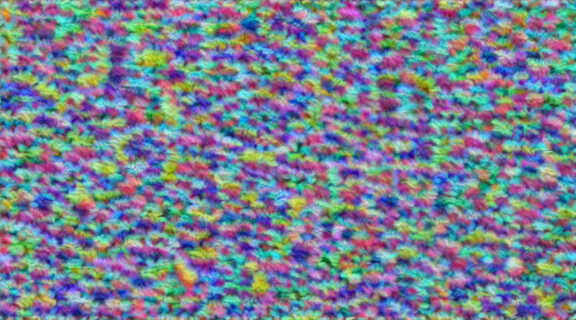

iter: 0, loss: 3.21, losses: 1.06, 0.0767, 0.988, 0.0456, 0.999, 0.047 (-0=>3.214)
iter: 10, loss: 2.87, losses: 0.963, 0.0798, 0.868, 0.0466, 0.866, 0.0468 (-0=>2.871)


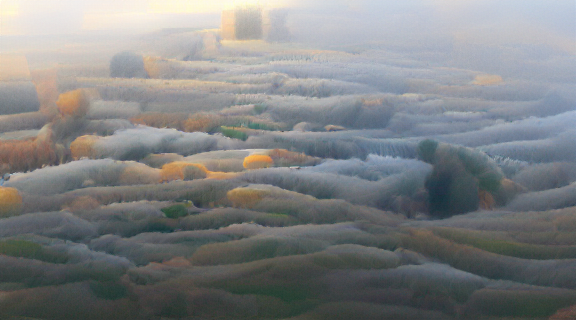

iter: 20, loss: 2.72, losses: 0.909, 0.0794, 0.812, 0.0487, 0.822, 0.0475 (-0=>2.719)
iter: 30, loss: 2.65, losses: 0.892, 0.0794, 0.792, 0.0492, 0.793, 0.0494 (-1=>2.624)


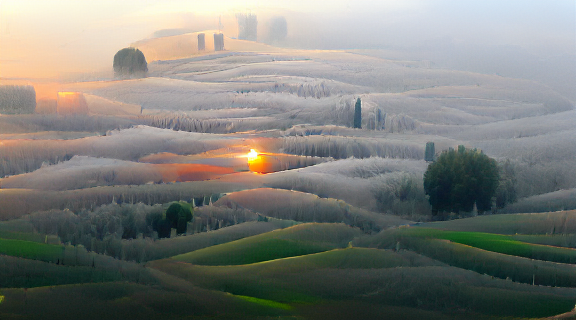

iter: 40, loss: 2.59, losses: 0.874, 0.0801, 0.77, 0.0515, 0.763, 0.051 (-4=>2.581)
iter: 50, loss: 2.58, losses: 0.863, 0.0825, 0.77, 0.0525, 0.766, 0.0511 (-1=>2.493)


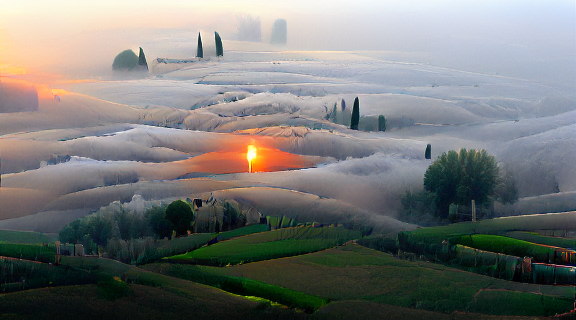

iter: 60, loss: 2.57, losses: 0.863, 0.0816, 0.761, 0.0547, 0.757, 0.0511 (-4=>2.455)
iter: 70, loss: 2.45, losses: 0.803, 0.0845, 0.728, 0.0582, 0.727, 0.0537 (-0=>2.455)


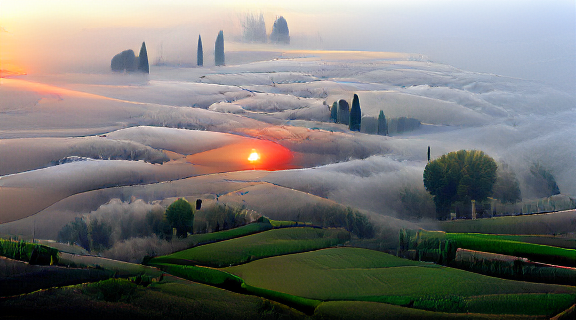

iter: 80, loss: 2.52, losses: 0.847, 0.0825, 0.743, 0.0565, 0.742, 0.0525 (-3=>2.435)
iter: 90, loss: 2.43, losses: 0.801, 0.0844, 0.716, 0.0586, 0.718, 0.0542 (-2=>2.431)


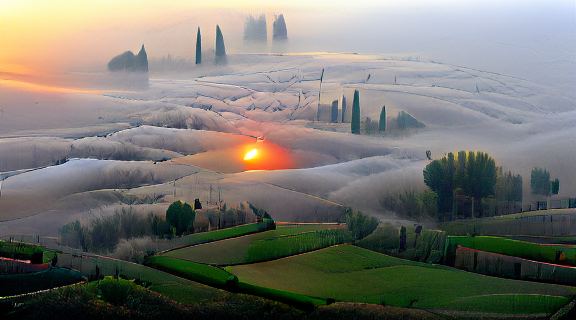

iter: 100, loss: 2.53, losses: 0.84, 0.0832, 0.751, 0.0546, 0.747, 0.0525 (-12=>2.431)
iter: 110, loss: 2.44, losses: 0.803, 0.0845, 0.722, 0.0563, 0.721, 0.0523 (-22=>2.431)


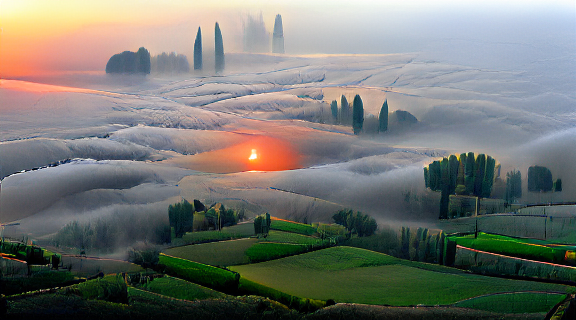

iter: 120, loss: 2.51, losses: 0.83, 0.0829, 0.745, 0.0556, 0.746, 0.0513 (-1=>2.421)
iter: 130, loss: 2.42, losses: 0.798, 0.0844, 0.717, 0.0573, 0.714, 0.054 (-11=>2.421)


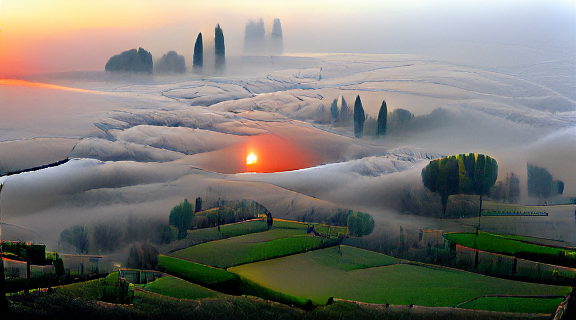

iter: 140, loss: 2.42, losses: 0.794, 0.0829, 0.721, 0.0569, 0.715, 0.053 (-3=>2.402)
iter: 150, loss: 2.53, losses: 0.843, 0.0821, 0.755, 0.0541, 0.745, 0.0519 (-13=>2.402)


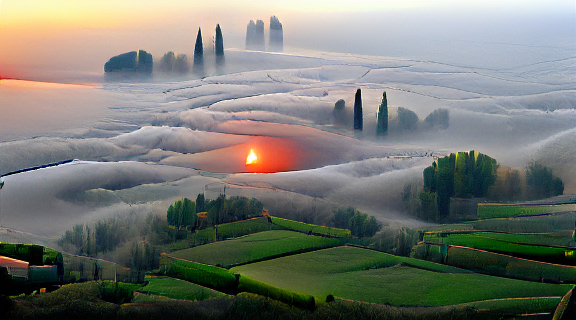

iter: 160, loss: 2.48, losses: 0.828, 0.0816, 0.729, 0.0569, 0.73, 0.0525 (-23=>2.402)
iter: 170, loss: 2.54, losses: 0.851, 0.0813, 0.754, 0.0534, 0.744, 0.0524 (-6=>2.399)


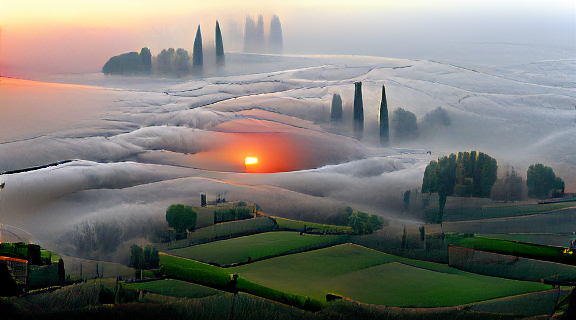

iter: 180, loss: 2.39, losses: 0.78, 0.084, 0.706, 0.0599, 0.707, 0.0551 (-0=>2.393)
iter: 190, loss: 2.42, losses: 0.8, 0.0838, 0.717, 0.057, 0.712, 0.0533 (-10=>2.393)


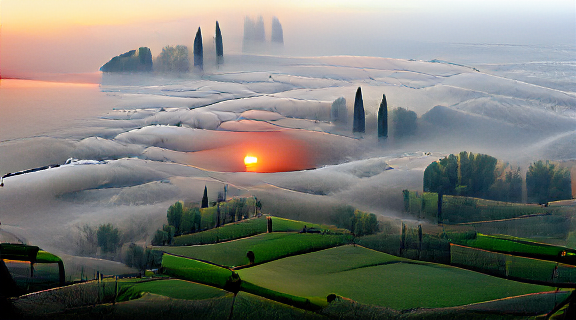

iter: 200, loss: 2.5, losses: 0.835, 0.0825, 0.739, 0.055, 0.735, 0.0524 (-20=>2.393)
iter: 210, loss: 2.5, losses: 0.833, 0.0827, 0.739, 0.056, 0.733, 0.0535 (-30=>2.393)


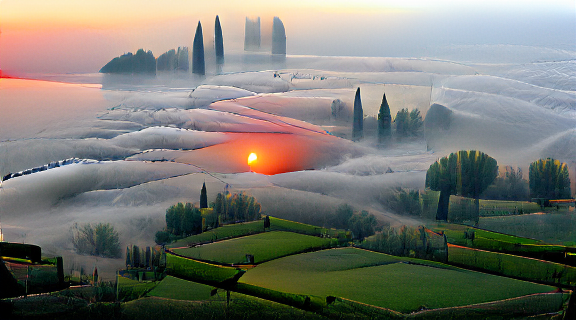

iter: 220, loss: 2.41, losses: 0.787, 0.0853, 0.717, 0.0562, 0.715, 0.0522 (-40=>2.393)
Dropping learning rate
iter: 230, loss: 2.39, losses: 0.781, 0.0838, 0.708, 0.0588, 0.706, 0.0548 (-0=>2.393)


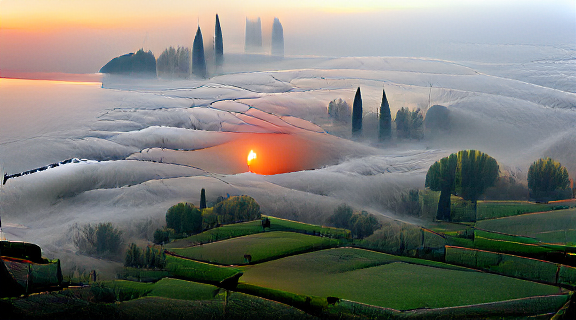

iter: 240, loss: 2.49, losses: 0.825, 0.0832, 0.738, 0.0565, 0.736, 0.0527 (-10=>2.393)
iter: 250, loss: 2.46, losses: 0.811, 0.0835, 0.734, 0.0569, 0.724, 0.0542 (-3=>2.387)


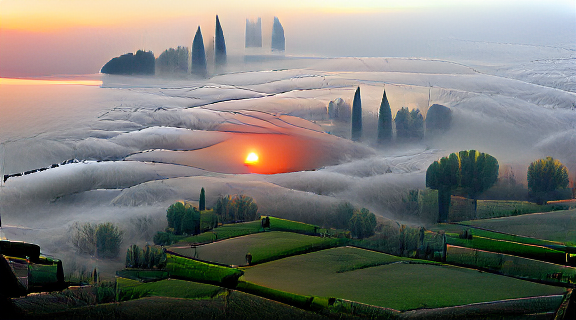

iter: 260, loss: 2.39, losses: 0.781, 0.0836, 0.71, 0.0577, 0.704, 0.0539 (-13=>2.387)
iter: 270, loss: 2.4, losses: 0.786, 0.0846, 0.71, 0.0575, 0.703, 0.0546 (-1=>2.384)


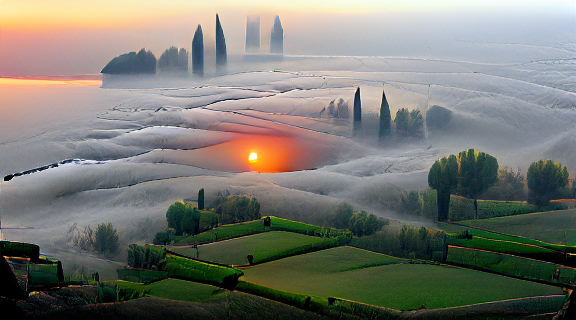

iter: 280, loss: 2.5, losses: 0.832, 0.0823, 0.744, 0.0554, 0.737, 0.0528 (-11=>2.384)
iter: 290, loss: 2.42, losses: 0.794, 0.0835, 0.719, 0.0573, 0.718, 0.0535 (-21=>2.384)


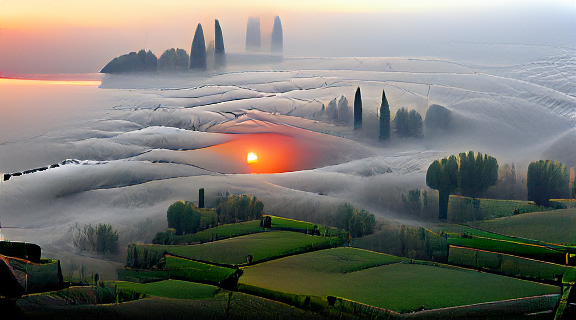

iter: 300, finished (-31=>2.384)



True

In [ ]:
#@title 1st Generation { vertical-output: true }
import sys
sys.path.append("pixray")
import pixray
pixray.reset_settings()
pixray.add_settings(prompts="a view of a foggy sunrise in Italy", quality="better", drawer="vqgan", seed=199)
settings = pixray.apply_settings()
pixray.do_init(settings)
pixray.do_run(settings)


#### An amazing thing with pixray and AI art in general is that nothing needs to be trained, and no data except a text prompt from us will be needed for the generation, while making a singular piece of art will still be reasonably fast. 

#### Right now we're using the VQGAN+CLIP model combo, let's make a few more images and see what kinds of output it can produce...
Going for our second run - the prompt is: "🌄 🏜, acrylic paint on canvas | trending on artstation"
yes! CLIP understand emojis!


Using seed: 10168427107772652677
reusing cached copy of model  models/vqgan_imagenet_f16_16384.ckpt
Using device: cuda:0
Optimising using: Adam
Using text prompts: ['🌄 🏜, acrylic paint on canvas', 'trending on artstation']


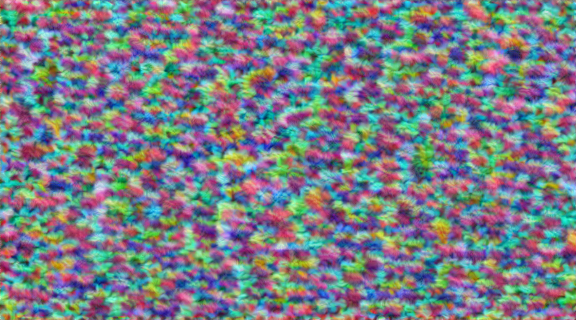

iter: 0, loss: 5.94, losses: 0.999, 1.02, 0.0769, 0.945, 0.935, 0.0461, 0.945, 0.933, 0.0473 (-0=>5.943)
iter: 10, loss: 5.5, losses: 0.908, 0.987, 0.0812, 0.81, 0.897, 0.0451, 0.824, 0.899, 0.0456 (-0=>5.497)


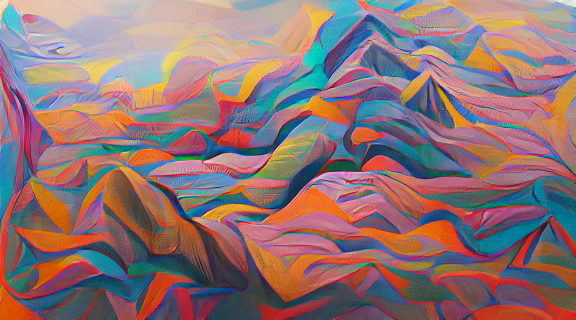

iter: 20, loss: 5.41, losses: 0.883, 0.983, 0.0834, 0.795, 0.879, 0.0449, 0.807, 0.885, 0.047 (-4=>5.405)
iter: 30, loss: 5.39, losses: 0.874, 0.976, 0.0844, 0.8, 0.878, 0.0455, 0.797, 0.887, 0.0466 (-4=>5.309)


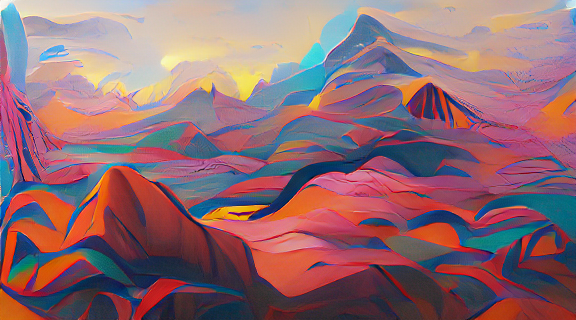

iter: 40, loss: 5.28, losses: 0.851, 0.964, 0.0847, 0.774, 0.864, 0.0451, 0.773, 0.873, 0.0467 (-1=>5.252)
iter: 50, loss: 5.27, losses: 0.85, 0.959, 0.0861, 0.776, 0.865, 0.0458, 0.772, 0.871, 0.0474 (-1=>5.208)


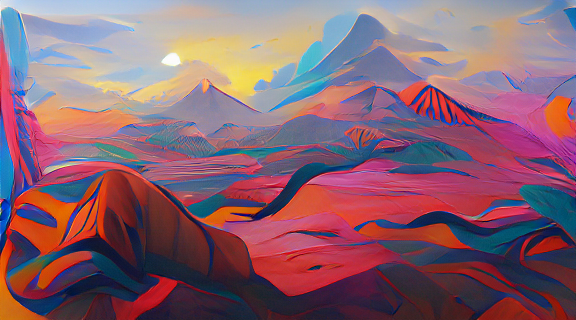

iter: 60, loss: 5.2, losses: 0.831, 0.944, 0.0862, 0.762, 0.855, 0.0466, 0.761, 0.868, 0.0474 (-5=>5.183)
iter: 70, loss: 5.22, losses: 0.842, 0.946, 0.0851, 0.766, 0.856, 0.0459, 0.764, 0.868, 0.0474 (-2=>5.14)


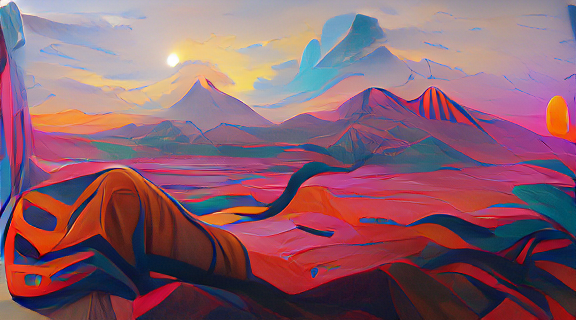

iter: 80, loss: 5.17, losses: 0.815, 0.942, 0.0877, 0.757, 0.857, 0.0465, 0.743, 0.871, 0.0475 (-12=>5.14)
iter: 90, loss: 5.2, losses: 0.83, 0.947, 0.0854, 0.762, 0.861, 0.0463, 0.753, 0.869, 0.0471 (-22=>5.14)


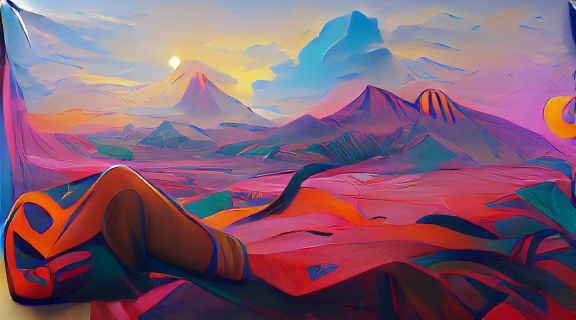

iter: 100, loss: 5.2, losses: 0.829, 0.95, 0.0867, 0.765, 0.858, 0.0465, 0.754, 0.866, 0.0469 (-32=>5.14)
iter: 110, loss: 5.23, losses: 0.841, 0.953, 0.0858, 0.771, 0.862, 0.0462, 0.758, 0.866, 0.0473 (-3=>5.125)


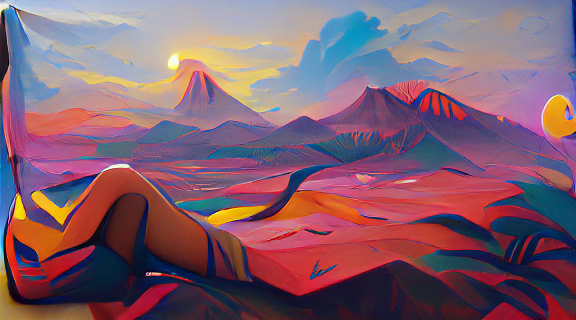

iter: 120, loss: 5.19, losses: 0.826, 0.941, 0.0865, 0.761, 0.862, 0.0472, 0.751, 0.865, 0.0474 (-7=>5.104)
iter: 130, loss: 5.15, losses: 0.82, 0.932, 0.087, 0.759, 0.855, 0.0477, 0.75, 0.855, 0.0477 (-5=>5.089)


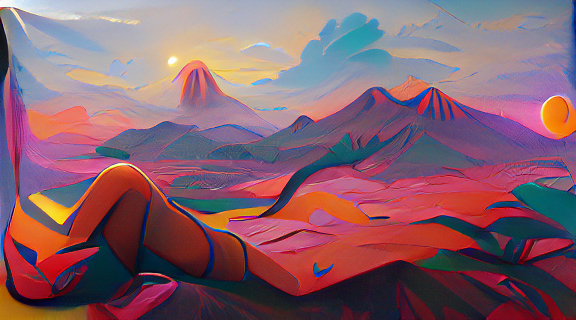

iter: 140, loss: 5.13, losses: 0.803, 0.944, 0.0885, 0.747, 0.856, 0.0471, 0.735, 0.864, 0.0488 (-15=>5.089)
iter: 150, loss: 5.2, losses: 0.828, 0.942, 0.0871, 0.771, 0.857, 0.0474, 0.761, 0.858, 0.049 (-2=>5.085)


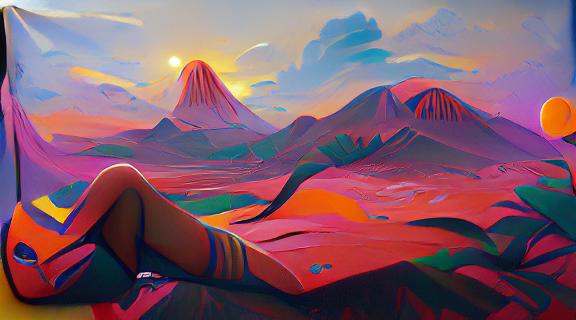

iter: 160, loss: 5.11, losses: 0.808, 0.93, 0.0884, 0.744, 0.85, 0.0478, 0.737, 0.853, 0.0487 (-6=>5.084)
iter: 170, loss: 5.14, losses: 0.808, 0.937, 0.0881, 0.748, 0.86, 0.0481, 0.736, 0.862, 0.0485 (-16=>5.084)


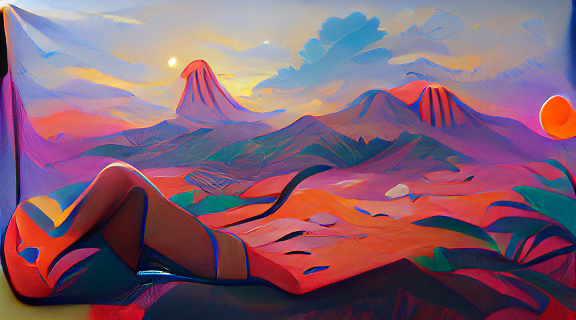

iter: 180, loss: 5.1, losses: 0.799, 0.932, 0.0877, 0.74, 0.858, 0.0483, 0.727, 0.861, 0.0488 (-26=>5.084)
iter: 190, loss: 5.18, losses: 0.827, 0.942, 0.0875, 0.762, 0.855, 0.0472, 0.751, 0.861, 0.0482 (-7=>5.082)


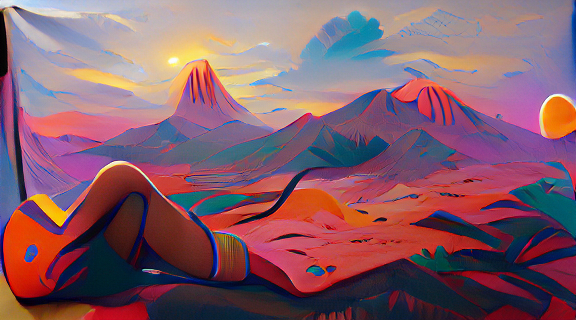

iter: 200, loss: 5.14, losses: 0.818, 0.929, 0.0882, 0.756, 0.855, 0.0483, 0.747, 0.85, 0.0484 (-17=>5.082)
iter: 210, loss: 5.16, losses: 0.824, 0.943, 0.0875, 0.751, 0.859, 0.0494, 0.739, 0.854, 0.0494 (-27=>5.082)


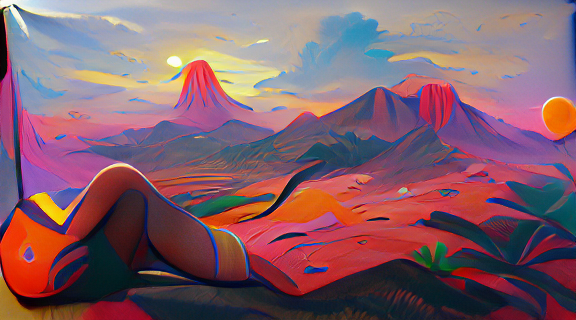

iter: 220, loss: 5.1, losses: 0.805, 0.927, 0.0882, 0.745, 0.852, 0.0488, 0.728, 0.853, 0.0492 (-37=>5.082)
Dropping learning rate
iter: 230, loss: 5.15, losses: 0.816, 0.945, 0.0875, 0.752, 0.858, 0.0475, 0.743, 0.854, 0.048 (-1=>5.051)


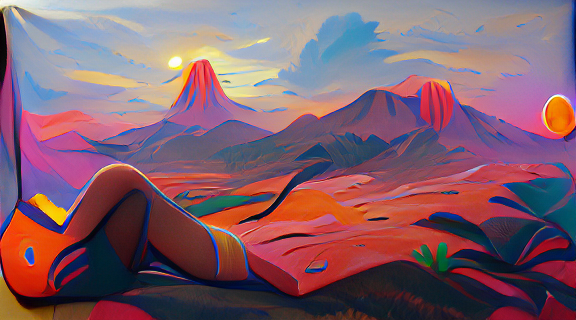

iter: 240, loss: 5.06, losses: 0.788, 0.925, 0.0883, 0.733, 0.852, 0.0495, 0.722, 0.849, 0.0512 (-9=>5.042)
iter: 250, loss: 5.06, losses: 0.792, 0.92, 0.089, 0.738, 0.85, 0.0489, 0.724, 0.851, 0.0497 (-19=>5.042)


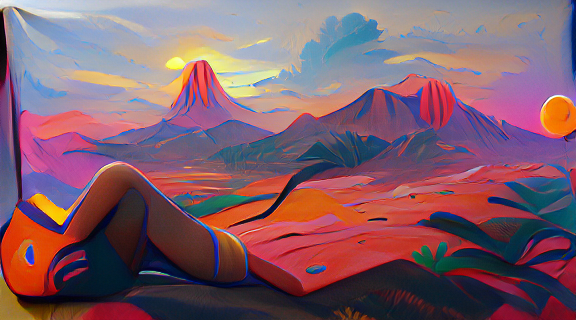

iter: 260, loss: 5.18, losses: 0.821, 0.941, 0.0879, 0.764, 0.858, 0.0481, 0.749, 0.859, 0.0489 (-29=>5.042)
iter: 270, loss: 5.15, losses: 0.814, 0.935, 0.0877, 0.755, 0.856, 0.0479, 0.743, 0.861, 0.0488 (-39=>5.042)


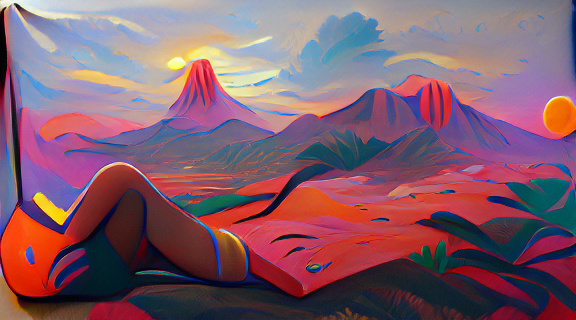

iter: 280, loss: 5.16, losses: 0.816, 0.949, 0.0877, 0.752, 0.859, 0.0472, 0.74, 0.859, 0.0489 (-49=>5.042)
iter: 290, loss: 5.05, losses: 0.788, 0.921, 0.0893, 0.733, 0.852, 0.0494, 0.718, 0.848, 0.0497 (-7=>5.04)


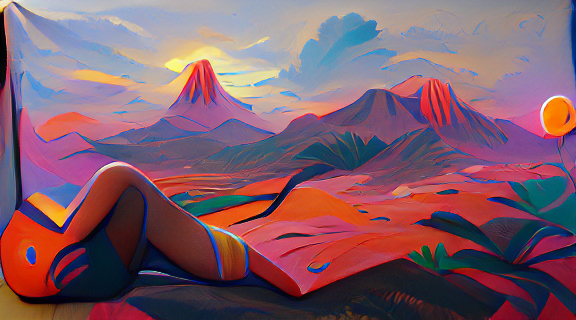

iter: 300, finished (-17=>5.04)



True

In [ ]:
#@title 2nd Generation{ vertical-output: true }
pixray.reset_settings()
pixray.add_settings(prompts="🌄 🏜, acrylic paint on canvas | trending on artstation", quality="better", drawer="vqgan")
settings = pixray.apply_settings()
pixray.do_init(settings)
pixray.do_run(settings)



#### Let's do our final run, prompt = "🌄 🏜 | watercolor by JMW Turner", but now specifying an artist - JMW Turner, an English painter and watercolorist, famous for his imaginative landscapes
#### nice! A watercolor sunrise in the desert, exactly what we wanted!


Using seed: 17990808810653192001
reusing cached copy of model  models/vqgan_imagenet_f16_16384.ckpt
All CLIP models already loaded:  ['RN50', 'ViT-B/32', 'ViT-B/16']
Using device: cuda:0
Optimising using: Adam
Using text prompts: ['🌄 🏜', 'watercolor by JMW Turner']


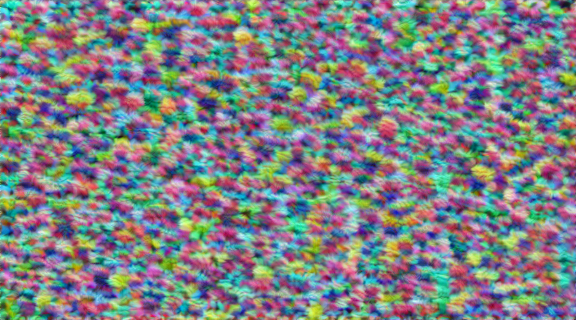

iter: 0, loss: 6.08, losses: 0.994, 1.07, 0.0771, 0.921, 0.992, 0.046, 0.91, 1.02, 0.0469 (-0=>6.079)
iter: 10, loss: 5.48, losses: 0.972, 0.892, 0.0777, 0.887, 0.856, 0.0475, 0.855, 0.842, 0.0479 (-0=>5.477)


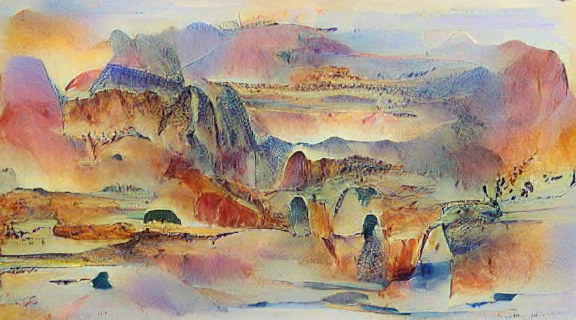

iter: 20, loss: 5.27, losses: 0.932, 0.854, 0.0812, 0.85, 0.808, 0.05, 0.836, 0.81, 0.047 (-0=>5.267)
iter: 30, loss: 5.16, losses: 0.928, 0.826, 0.0825, 0.832, 0.773, 0.0541, 0.83, 0.779, 0.0517 (-0=>5.156)


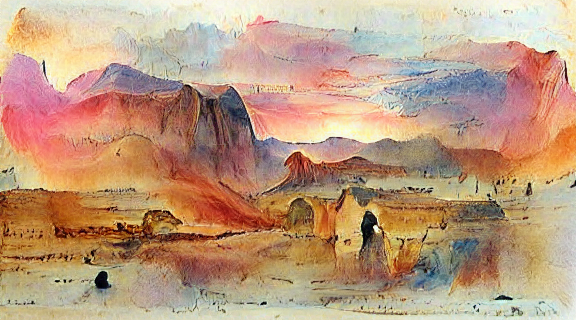

iter: 40, loss: 5.1, losses: 0.917, 0.814, 0.0821, 0.819, 0.767, 0.0572, 0.808, 0.78, 0.0534 (-0=>5.097)
iter: 50, loss: 5.19, losses: 0.933, 0.841, 0.0814, 0.833, 0.783, 0.0534, 0.829, 0.784, 0.0518 (-6=>5.093)


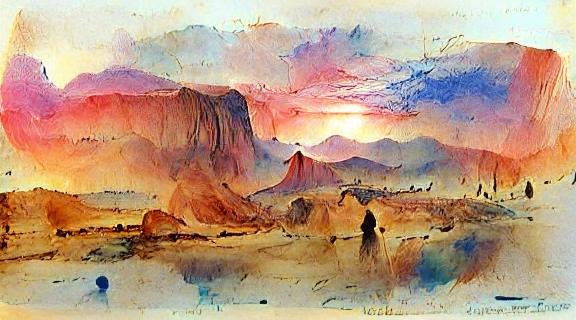

iter: 60, loss: 5.15, losses: 0.925, 0.837, 0.0824, 0.828, 0.774, 0.0547, 0.822, 0.778, 0.0522 (-2=>5.074)
iter: 70, loss: 5.13, losses: 0.915, 0.833, 0.0831, 0.824, 0.769, 0.0559, 0.82, 0.774, 0.053 (-8=>5.062)


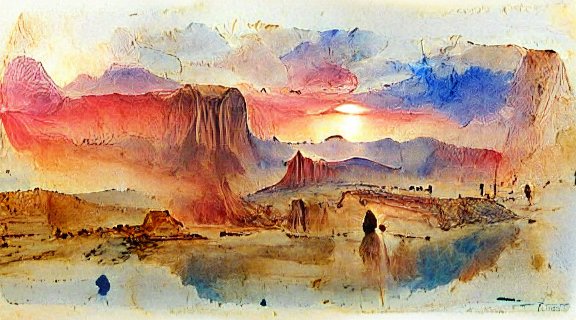

iter: 80, loss: 5.05, losses: 0.91, 0.798, 0.0821, 0.811, 0.759, 0.0576, 0.81, 0.768, 0.0551 (-0=>5.051)
iter: 90, loss: 5.14, losses: 0.929, 0.835, 0.0812, 0.823, 0.771, 0.0564, 0.817, 0.779, 0.0534 (-10=>5.051)


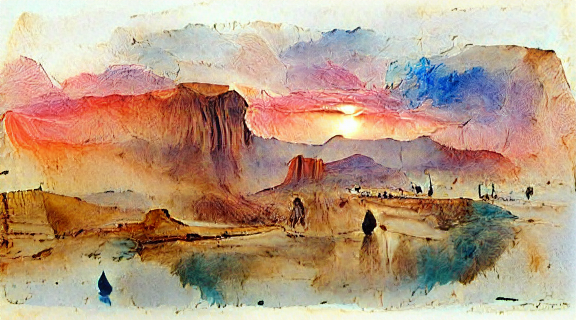

iter: 100, loss: 5.12, losses: 0.924, 0.818, 0.0818, 0.828, 0.768, 0.0563, 0.819, 0.772, 0.0536 (-6=>5.022)
iter: 110, loss: 5.16, losses: 0.924, 0.83, 0.0812, 0.835, 0.777, 0.0551, 0.822, 0.779, 0.0531 (-8=> 5)


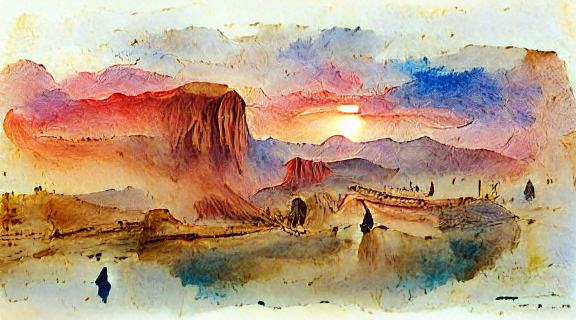

iter: 120, loss: 5.12, losses: 0.926, 0.819, 0.0812, 0.829, 0.764, 0.0578, 0.819, 0.772, 0.0548 (-18=> 5)
iter: 130, loss: 5.02, losses: 0.906, 0.787, 0.0811, 0.812, 0.756, 0.0573, 0.799, 0.765, 0.0545 (-28=> 5)


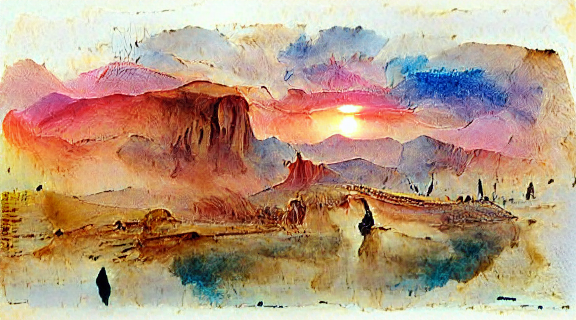

iter: 140, loss: 5.12, losses: 0.935, 0.824, 0.08, 0.825, 0.766, 0.0555, 0.816, 0.767, 0.0536 (-38=> 5)
iter: 150, loss: 5.13, losses: 0.929, 0.826, 0.0817, 0.826, 0.771, 0.0556, 0.816, 0.773, 0.0535 (-48=> 5)


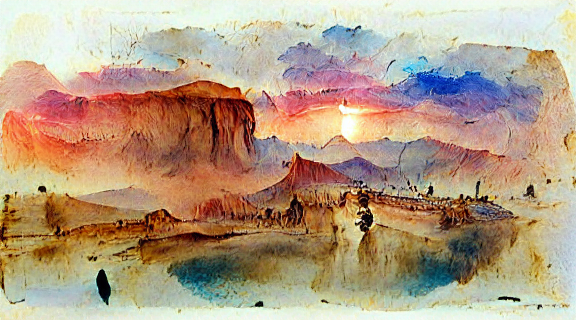

iter: 160, loss: 5.03, losses: 0.918, 0.786, 0.0814, 0.811, 0.757, 0.0561, 0.795, 0.77, 0.0533 (-58=> 5)
iter: 170, loss: 5.15, losses: 0.93, 0.826, 0.0816, 0.83, 0.77, 0.0547, 0.822, 0.778, 0.0529 (-68=> 5)


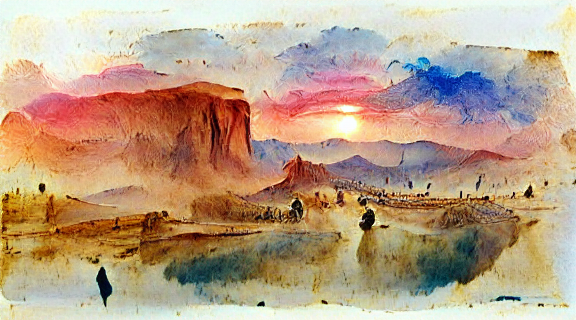

iter: 180, loss: 5.01, losses: 0.903, 0.795, 0.0825, 0.802, 0.753, 0.0575, 0.792, 0.764, 0.0565 (-78=> 5)
iter: 190, loss: 5.1, losses: 0.916, 0.818, 0.0819, 0.814, 0.772, 0.0567, 0.805, 0.778, 0.0548 (-88=> 5)


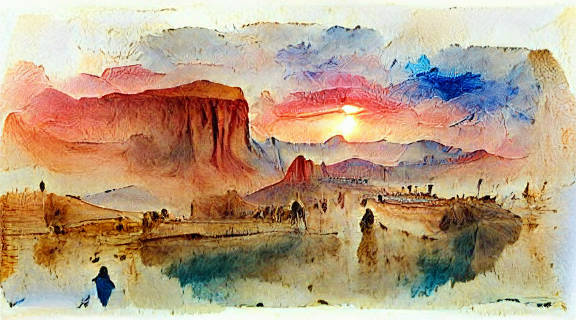

iter: 200, loss: 5.03, losses: 0.911, 0.788, 0.0825, 0.81, 0.758, 0.0581, 0.794, 0.774, 0.0552 (-98=> 5)
iter: 210, loss: 5.03, losses: 0.909, 0.798, 0.0815, 0.801, 0.761, 0.0562, 0.795, 0.776, 0.0536 (-108=> 5)


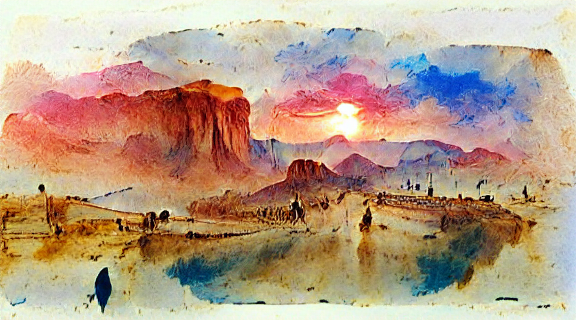

iter: 220, loss: 4.99, losses: 0.902, 0.791, 0.0824, 0.795, 0.759, 0.0569, 0.783, 0.77, 0.0551 (-0=>4.995)
Dropping learning rate
iter: 230, loss: 4.99, losses: 0.907, 0.784, 0.0823, 0.804, 0.748, 0.0576, 0.789, 0.766, 0.0548 (-0=>4.991)


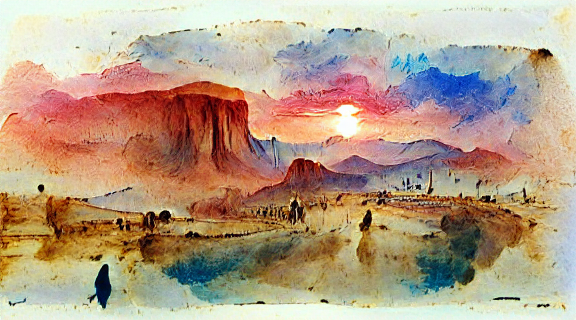

iter: 240, loss: 5, losses: 0.907, 0.784, 0.0818, 0.802, 0.749, 0.0588, 0.789, 0.77, 0.055 (-10=>4.991)
iter: 250, loss: 5.11, losses: 0.92, 0.826, 0.0808, 0.823, 0.768, 0.0557, 0.805, 0.777, 0.0529 (-8=>4.973)


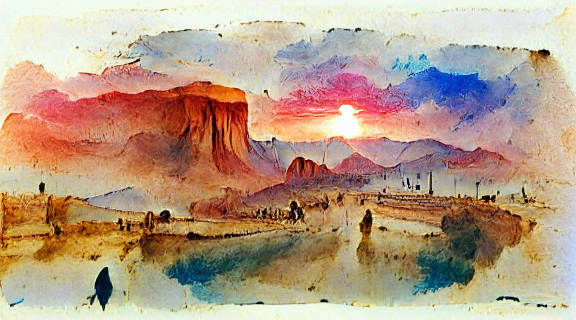

iter: 260, loss: 5.01, losses: 0.904, 0.792, 0.0829, 0.799, 0.758, 0.0581, 0.787, 0.769, 0.0558 (-18=>4.973)
iter: 270, loss: 4.98, losses: 0.901, 0.779, 0.0817, 0.803, 0.749, 0.0579, 0.789, 0.768, 0.0548 (-28=>4.973)


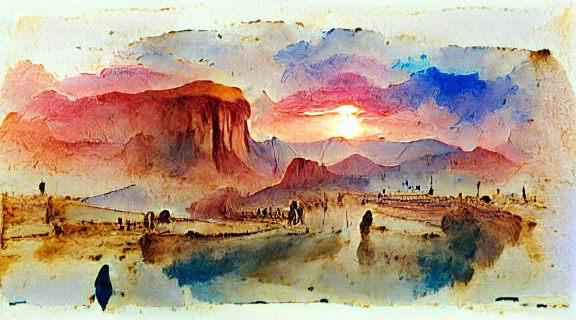

iter: 280, loss: 5.1, losses: 0.916, 0.819, 0.081, 0.826, 0.766, 0.0556, 0.808, 0.778, 0.0527 (-38=>4.973)
iter: 290, loss: 5.04, losses: 0.91, 0.802, 0.082, 0.817, 0.752, 0.0582, 0.802, 0.761, 0.0557 (-48=>4.973)


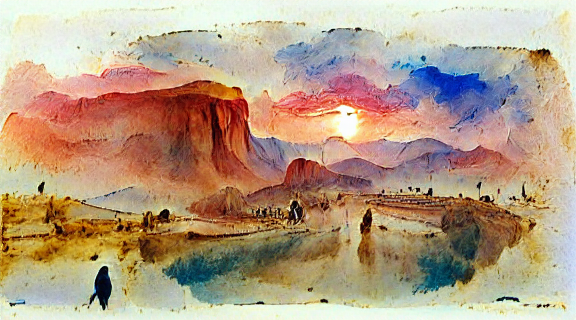

iter: 300, finished (-58=>4.973)



True

In [ ]:
#@title Final Generation { vertical-output: true }
pixray.reset_settings()
pixray.add_settings(prompts="🌄 🏜 | watercolor by JMW Turner", quality="better", drawer="vqgan")
settings = pixray.apply_settings()
pixray.do_init(settings)
pixray.do_run(settings)

#### These creations really show how powerful the VQGAN+CLIP can really be, especially with the right prompts to guide them. These pieces of text, such as "trending on artstation", or "by *some artist*", are ways to engineer and tune prompts. 

#### it tells CLIP that we want a certain *style* or *look* to the final image, be it an oil painting, or watercolor art, or the digital style of ArtStation. These are the ways we make our final art piece more appealing and beautiful, as well as to enhance some aspects and remove other aspects in the art.

<img src="https://dazhi.art/i/prompt relation.png" height="250">

#### Stay tuned for the next few threads😁!  I'm going to do an overview of the deep learning models that make AI art possible, and all about the mysterious process of prompt engineering 
#### (AND some tried-and-true phrases and artists that WORK!) 

#### If there's anything else you'd like to learn about AI generated art, or you see any errors i made here, feel free to comment below to notify me!